<a href="https://colab.research.google.com/github/CharuRathee/Disney-Hotstar-Clone/blob/main/Military_Aircraft_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Environment and Library Checks

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import glob
import shutil
import cv2
import os
from tqdm import tqdm
MODE = 'valid'# train, valid

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 757.2/757.2 kB 8.4 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-m

In [ ]:
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.2.18 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 29.9/78.2 GB disk)


In [ ]:
import torch

# Check if CUDA (GPU support) is available
if torch.cuda.is_available():
    print('CUDA is available. GPU will be used.')
else:
    print('CUDA is not available. CPU will be used.')

CUDA is available. GPU will be used.


# Defining Classes for Military Aircraft Detection

In [ ]:
classes = np.array(['A10','A400M','AG600','AV8B',
        'B1','B2','B52','Be200',
        'C130','C2','C17','C5','E2','E7','EF2000',
        'F117','F14','F15','F16','F18','F22','F35','F4',
        'JAS39','MQ9','Mig31','Mirage2000','P3','RQ4','Rafale',
        'SR71','Su34','Su57',
        'Tu160','Tu95','Tornado',
        'U2','US2', 'V22','XB70','YF23','Vulcan','J20',
        'KC135', 'J10', 'Su25', 'Su24','H6', 'JF17']
)
print(len(classes))

49


# Importing Kaggle Files and Preparing Dataset Structure

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"charurathee","key":"04c3cf646f58ad25a997a23ee66c3da0"}'}

In [ ]:
!ls -lha kaggle.json

-rw-r--r-- 1 root root 67 May 21 19:24 kaggle.json


In [ ]:
!pip install -q kaggle

In [ ]:
# The Kaggle API client expects this file to be in ~/.kaggle,
# so move it there.
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/

# This permissions change avoids a warning on Kaggle tool startup.
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets list

ref                                                            title                                           size  lastUpdated          downloadCount  voteCount  usabilityRating  
-------------------------------------------------------------  ---------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
rahulvyasm/netflix-movies-and-tv-shows                         Netflix Movies and TV Shows                      1MB  2024-04-10 09:48:38          21993        480  1.0              
jainaru/world-happiness-report-2024-yearly-updated             World Happiness Report- 2024                    62KB  2024-05-15 19:04:34           1998         39  1.0              
sahirmaharajj/school-student-daily-attendance                  School Student Daily Attendance                  2MB  2024-04-29 19:29:56           5873        123  1.0              
jainaru/thyroid-disease-data                                   Thyroid Disease Data       

In [ ]:
!kaggle datasets download -d a2015003713/militaryaircraftdetectiondataset

Dataset URL: https://www.kaggle.com/datasets/a2015003713/militaryaircraftdetectiondataset
License(s): unknown
100% 12.6G/12.6G [02:28<00:00, 114MB/s]
100% 12.6G/12.6G [02:28<00:00, 91.2MB/s]


In [ ]:
# Unzip the dataset
!unzip militaryaircraftdetectiondataset.zip -d /content/militaryaircraftdetectiondataset

Streaming output truncated to the last 5000 lines.
  inflating: /content/militaryaircraftdetectiondataset/dataset/d3bb7e234d752428218e9b1e31314f22.csv  
  inflating: /content/militaryaircraftdetectiondataset/dataset/d3bb7e234d752428218e9b1e31314f22.jpg  
  inflating: /content/militaryaircraftdetectiondataset/dataset/d3bba2d98cc91eed0be188c02eef652b.csv  
  inflating: /content/militaryaircraftdetectiondataset/dataset/d3bba2d98cc91eed0be188c02eef652b.jpg  
  inflating: /content/militaryaircraftdetectiondataset/dataset/d3bd64c61df9f77e872122ab9e065e65.csv  
  inflating: /content/militaryaircraftdetectiondataset/dataset/d3bd64c61df9f77e872122ab9e065e65.jpg  
  inflating: /content/militaryaircraftdetectiondataset/dataset/d3bd6ae57951c6c23dbb07663d019ec9.csv  
  inflating: /content/militaryaircraftdetectiondataset/dataset/d3bd6ae57951c6c23dbb07663d019ec9.jpg  
  inflating: /content/militaryaircraftdetectiondataset/dataset/d3bfae095acf417898d4b014c5310b2c.csv  
  inflating: /content/militarya

In [ ]:
!kaggle datasets download -d a2015003713/yolov7-military-plane

# Unzip the Downloaded Dataset
!unzip yolov7-military-plane.zip

# Verify the Contents
import os
print(os.listdir('/content'))

Dataset URL: https://www.kaggle.com/datasets/a2015003713/yolov7-military-plane
License(s): unknown
 98% 269M/274M [00:01<00:00, 292MB/s]
100% 274M/274M [00:01<00:00, 271MB/s]
Archive:  yolov7-military-plane.zip
  inflating: rtdetr-l-best.pt        
  inflating: rtdetr-l-best_46cls.pt  
  inflating: rtdetr-l-best_49cls.pt  
  inflating: yolov7-w6-best.pt       
  inflating: yolov8-m-best.pt        
['.config', 'kaggle.json', 'rtdetr-l-best_46cls.pt', 'yolov8-m-best.pt', 'militaryaircraftdetectiondataset', 'rtdetr-l-best.pt', 'rtdetr-l-best_49cls.pt', 'ultralytics', 'yolov7-w6-best.pt', 'yolov7-military-plane.zip', 'sample_data']


# Setting up Dataset and Directory Structure

In [ ]:
# Path to the unzipped dataset
dataset_path = '/content/militaryaircraftdetectiondataset/dataset'

# Collect CSV and JPG paths
csv_paths = glob.glob(os.path.join(dataset_path, '*.csv'))
jpg_paths = glob.glob(os.path.join(dataset_path, '*.jpg'))
csv_paths.sort()
jpg_paths.sort()
print('number of images:', len(csv_paths))

# Create necessary directories in the Colab environment
os.makedirs('/content/ultralytics/data/train/images', exist_ok=True)
os.makedirs('/content/ultralytics/data/train/labels', exist_ok=True)

os.makedirs('/content/ultralytics/data/valid/images', exist_ok=True)
os.makedirs('/content/ultralytics/data/valid/labels', exist_ok=True)

os.makedirs('/content/ultralytics/data/test/images', exist_ok=True)
os.makedirs('/content/ultralytics/data/test/labels', exist_ok=True)

number of images: 14088


# Preparing Dataset Annotations and File Structure

In [ ]:
for i, (csv_path, jpg_path) in enumerate(tqdm(zip(csv_paths, jpg_paths))):
    annotations = np.array(pd.read_csv(csv_path))

    if os.path.basename(csv_path)[0] in ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'a', 'b', 'f']:
        if MODE == 'train':
            jpg_file_path = '/content/ultralytics/data/train/images/' + os.path.basename(jpg_path)
            txt_file_path = '/content/ultralytics/data/train/labels/' + os.path.basename(csv_path)[:-4] + '.txt'
            shutil.copy(jpg_path, jpg_file_path)
        else:
            continue
    elif os.path.basename(csv_path)[0] in ['c', 'd', 'e']:
        name = os.path.splitext(os.path.basename(jpg_path))[0]
        new_name = ''.join(np.random.permutation(list(name)))
        jpg_file_path = '/content/ultralytics/data/valid/images/' + new_name + '.jpg'
        txt_file_path = '/content/ultralytics/data/valid/labels/' + new_name + '.txt'
        shutil.copy(jpg_path, jpg_file_path)
    else:
        continue

    with open(txt_file_path, mode='w') as f:
        try:
            for annotation in annotations:
                width = annotation[1]
                height = annotation[2]
                class_name = annotation[3]
                xmin = annotation[4]
                ymin = annotation[5]
                xmax = annotation[6]
                ymax = annotation[7]
                x_center = 0.5 * (xmin + xmax)
                y_center = 0.5 * (ymin + ymax)
                b_width = xmax - xmin
                b_height = ymax - ymin
                class_num = np.where(classes == class_name)[0][0]
                output_string = '{} {} {} {} {}\n'.format(
                    class_num,
                    x_center / width,
                    y_center / height,
                    b_width / width,
                    b_height / height
                )
                f.write(output_string)
        except:
            print(txt_file_path)
            raise

print('test:', len(glob.glob('/content/ultralytics/data/test/labels/*.txt')))
print('valid:', len(glob.glob('/content/ultralytics/data/valid/labels/*.txt')))
print('train:', len(glob.glob('/content/ultralytics/data/train/labels/*.txt')))

14088it [00:33, 419.03it/s]


test: 0
valid: 10541
train: 0


# Generating YAML Configuration File

In [ ]:
# Generate the classes string for the YAML file
classes_string = ', '.join([f'"{c}"' for c in classes])


yaml_content = f"""
train: /content/ultralytics/data/train
val: /content/ultralytics/data/valid
test: /content/ultralytics/data/test
nc: {len(classes)}
names: [{classes_string}]
"""

yaml_file_path = '/content/ultralytics/data/mad.yaml'
os.makedirs(os.path.dirname(yaml_file_path), exist_ok=True)
with open(yaml_file_path, mode='w') as f:
    f.write(yaml_content.strip())

print(yaml_content)


train: /content/ultralytics/data/train
val: /content/ultralytics/data/valid
test: /content/ultralytics/data/test
nc: 49
names: ["A10", "A400M", "AG600", "AV8B", "B1", "B2", "B52", "Be200", "C130", "C2", "C17", "C5", "E2", "E7", "EF2000", "F117", "F14", "F15", "F16", "F18", "F22", "F35", "F4", "JAS39", "MQ9", "Mig31", "Mirage2000", "P3", "RQ4", "Rafale", "SR71", "Su34", "Su57", "Tu160", "Tu95", "Tornado", "U2", "US2", "V22", "XB70", "YF23", "Vulcan", "J20", "KC135", "J10", "Su25", "Su24", "H6", "JF17"]



# Training RT-DETR Model

In [ ]:
if MODE == 'train':
    from ultralytics import RTDETR
    import os

    # Set the path to the pretrained model
    pretrained_model_path = '/content/rtdetr-l.pt'
    # Set the path to the data YAML file
    data_yaml_path = '/content/ultralytics/data/mad.yaml'

    # Initialize the RTDETR model
    model = RTDETR(model='rtdetr-l.pt')

    # Train the model
    result = model.train(
        name='RT-DETR_001',
        epochs=1,
        imgsz=640,  # 1280 on colab A100
        batch=4,  # 8 on colab A100
        # optimizer='auto',

        # augmentation
        close_mosaic=0,
        hsv_h=0.02,
        hsv_s=0.75,
        hsv_v=0.45,
        degrees=0.1,
        translate=0.25,
        scale=0.55,
        shear=0.1,
        perspective=0.0,
        flipud=0.1,
        fliplr=0.5,
        mosaic=1.0,
        mixup=0.5,

        pretrained=pretrained_model_path,
        data=data_yaml_path,
    )

# Clearing CUDA Cache

In [ ]:
import torch
torch.cuda.empty_cache()

# Validating Trained Weights with YOLO

In [ ]:
# validate trained weights
!yolo val \
model='/content/rtdetr-l-best_49cls.pt' \
data='/content/ultralytics/data/mad.yaml' \
augment \
batch=8 \
imgsz=640

Ultralytics YOLOv8.2.18 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
rt-detr-l summary: 498 layers, 32084435 parameters, 0 gradients, 103.6 GFLOPs
val: Scanning /content/ultralytics/data/valid/labels.cache... 10537 images, 1 backgrounds, 4 corrupt: 100% 10541/10541 [00:00<?, ?it/s]
val: WARNING ⚠️ /content/ultralytics/data/valid/images/0289eddc876b0348e1864790626adc55.jpg: corrupt JPEG restored and saved
val: WARNING ⚠️ /content/ultralytics/data/valid/images/08317f1e28d16f628c8f776fdfe3089f.jpg: corrupt JPEG restored and saved
val: WARNING ⚠️ /content/ultralytics/data/valid/images/0e694cc7ba17386288e50625d6d8d490.jpg:

# Listing PNG Files

In [ ]:
import os
from glob import glob

# List all PNG files in the directory
png_files = glob('/content/runs/detect/val3/*.png')
print(png_files)

['/content/runs/detect/val3/R_curve.png', '/content/runs/detect/val3/confusion_matrix_normalized.png', '/content/runs/detect/val3/PR_curve.png', '/content/runs/detect/val3/confusion_matrix.png', '/content/runs/detect/val3/F1_curve.png', '/content/runs/detect/val3/P_curve.png']


# Visualizing Detected Objects in Images with OpenCV and Matplotlib

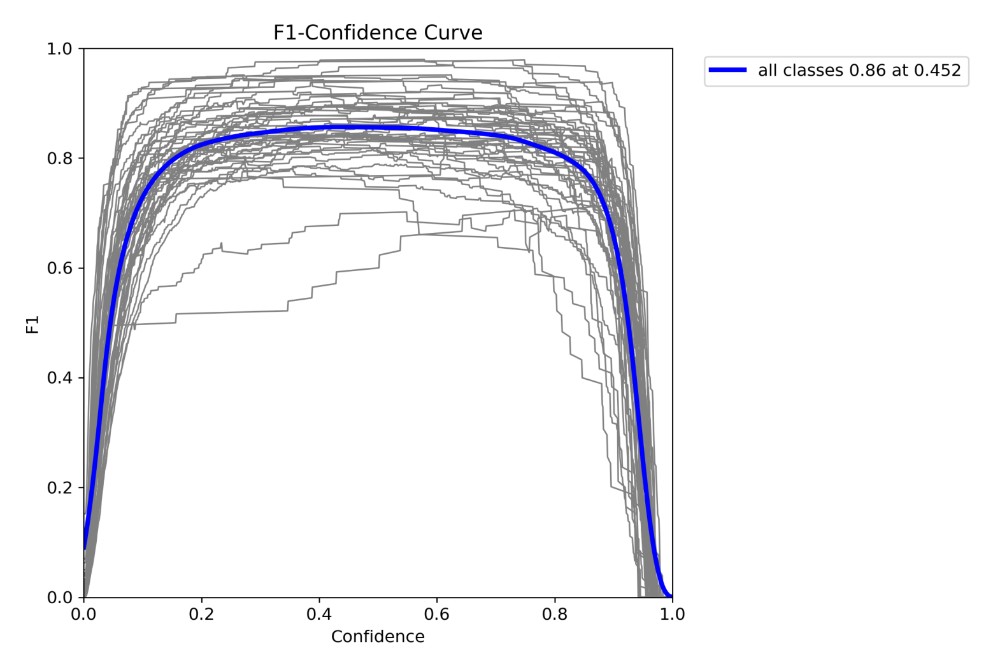

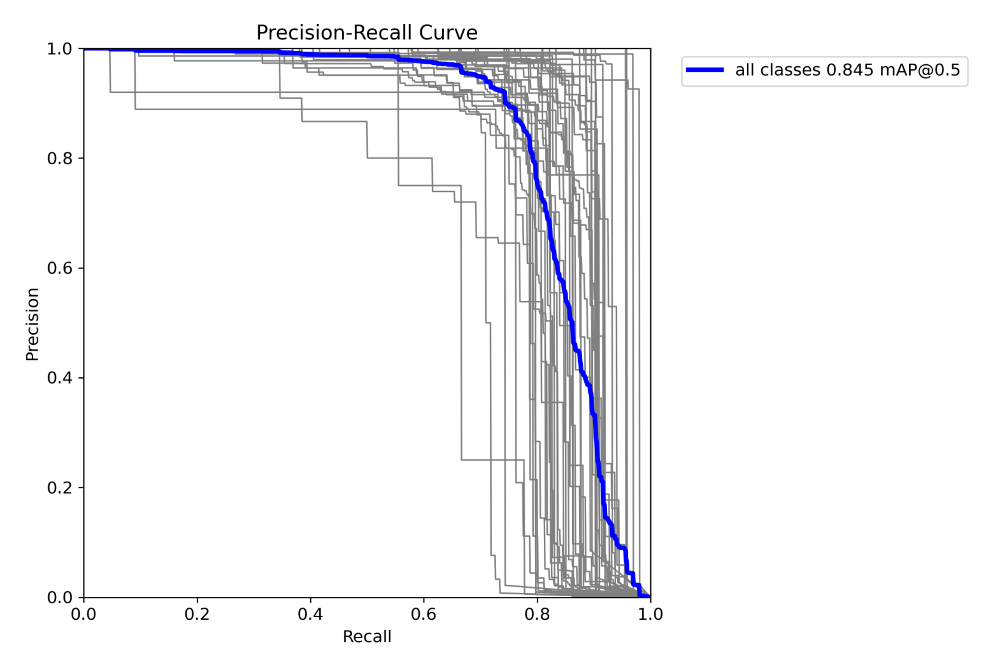

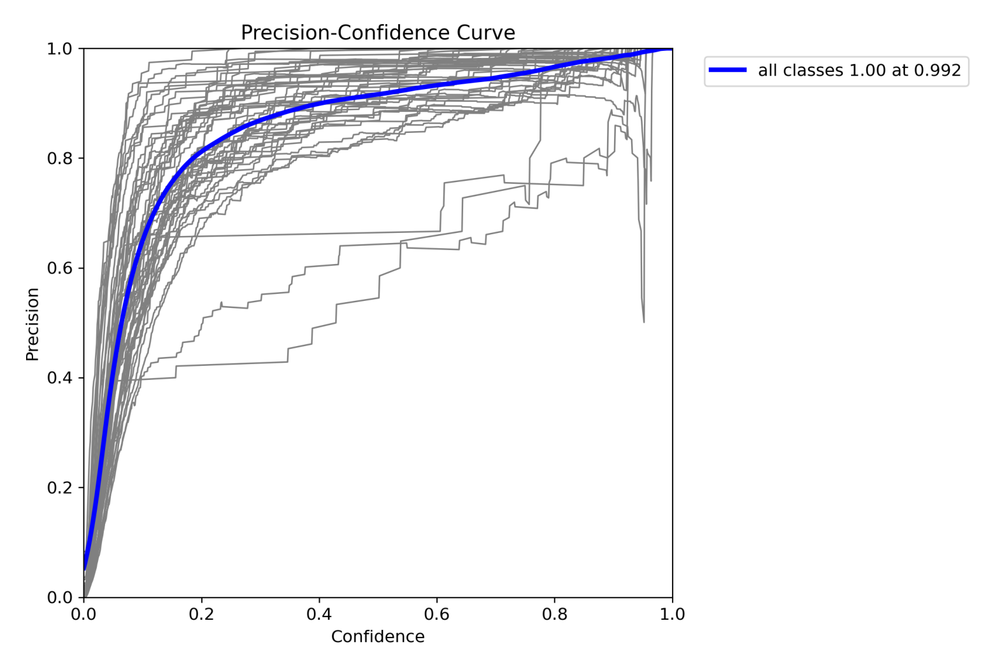

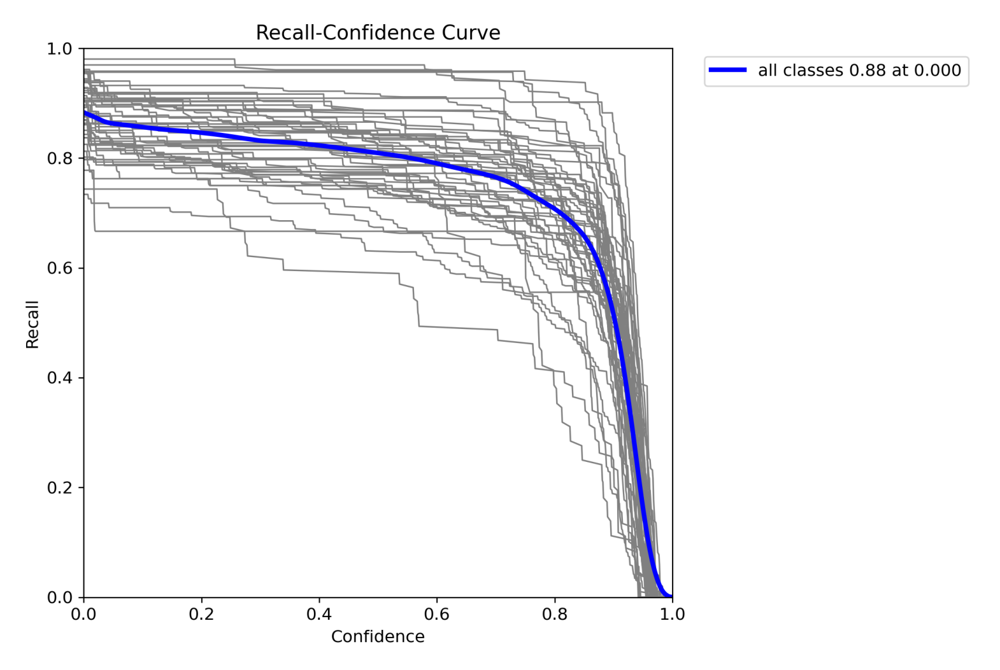

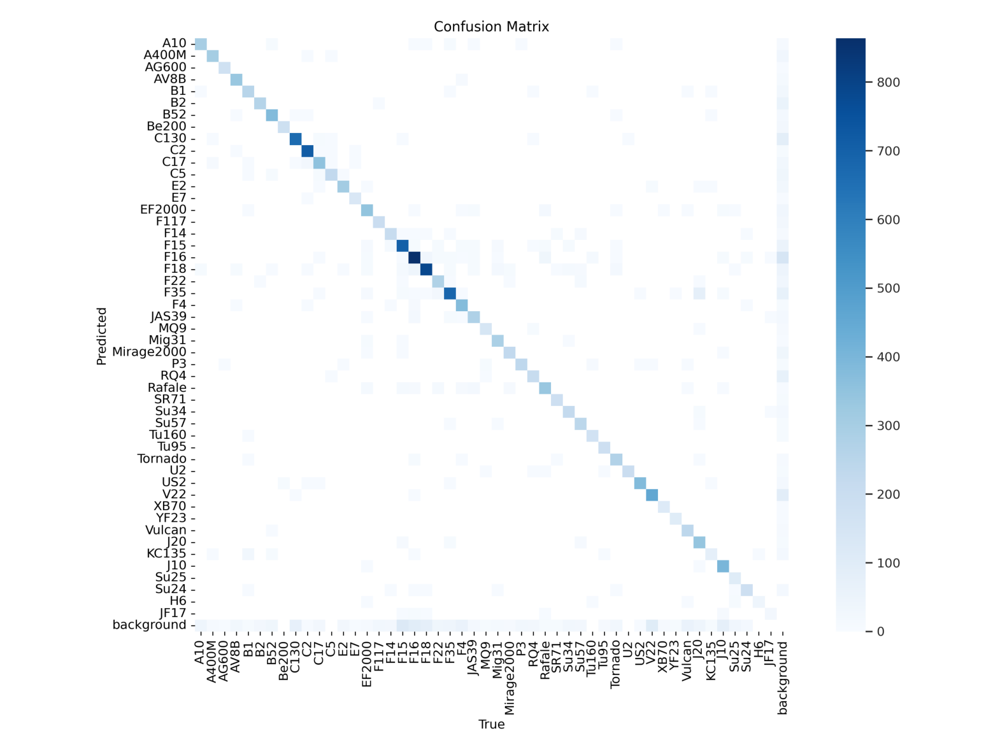

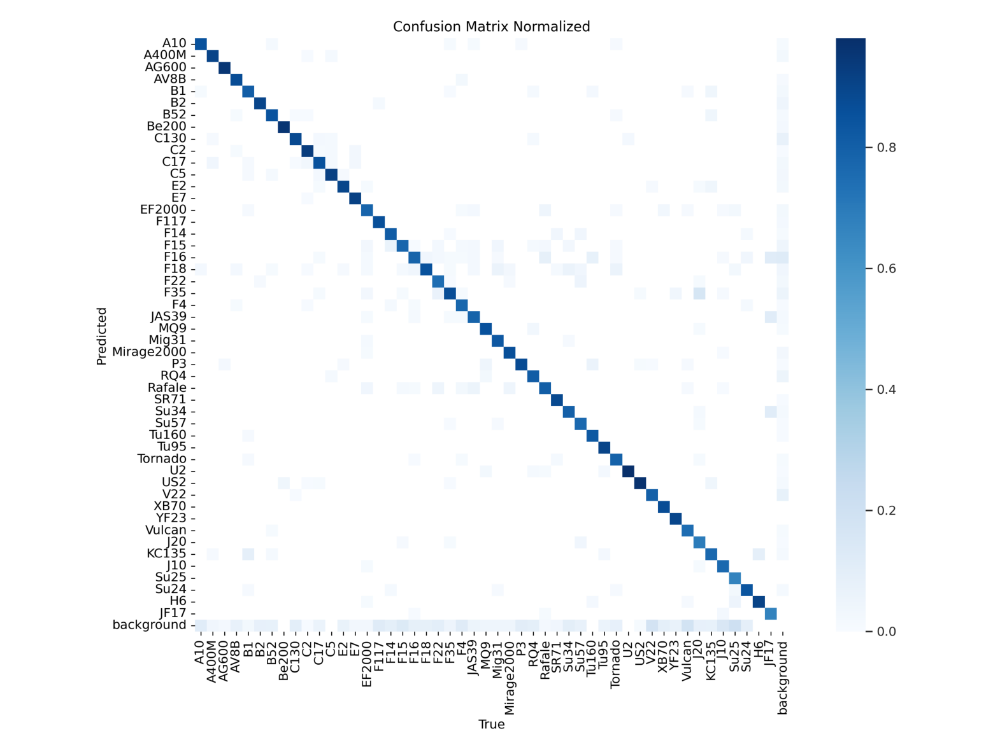

In [ ]:
import cv2
import glob  # Import the glob module

import matplotlib.pyplot as plt

# Loop through images in the specified directory
for path in sorted(glob.glob('/content/runs/detect/val3/*.png')):
    # Read the image
    image = cv2.imread(path)

    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Display the image
    plt.figure(figsize=(20,20))
    plt.imshow(image_rgb)
    plt.axis('off')  # Turn off axis
    plt.show()

# Image Visualization from Detection Results

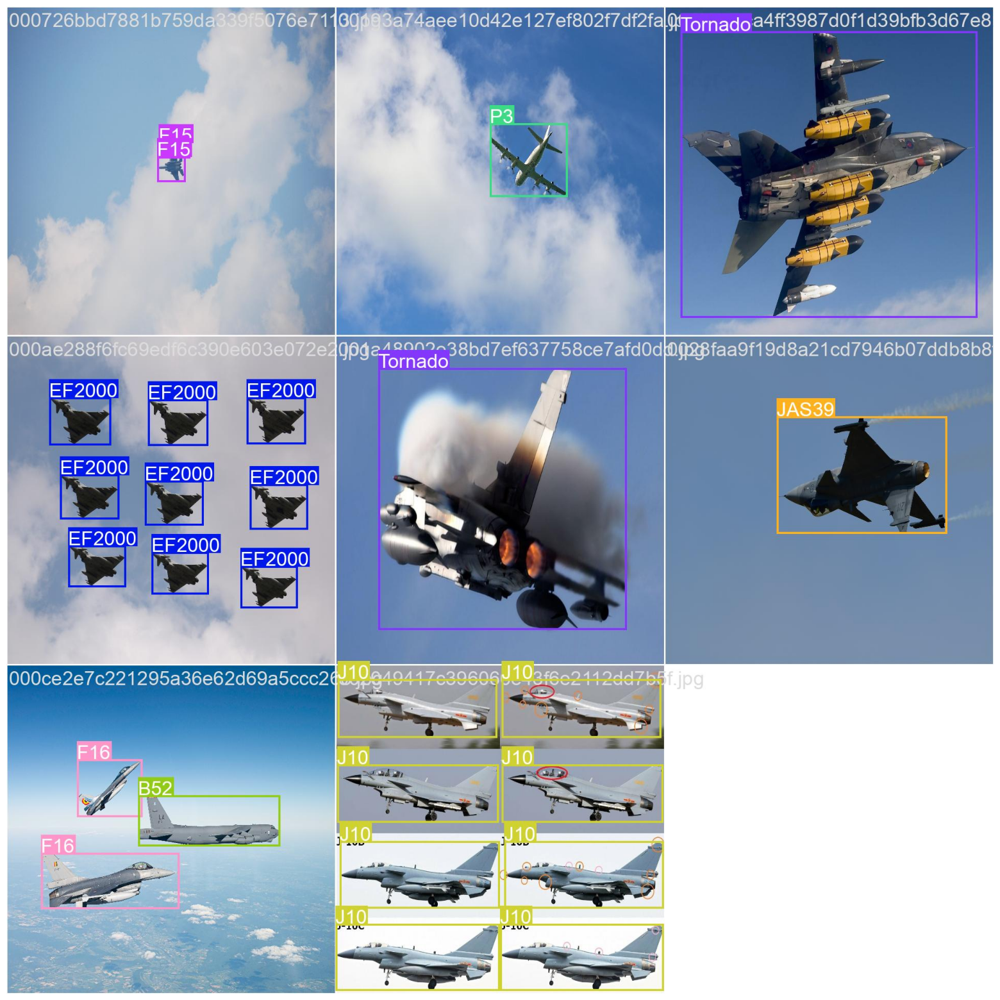

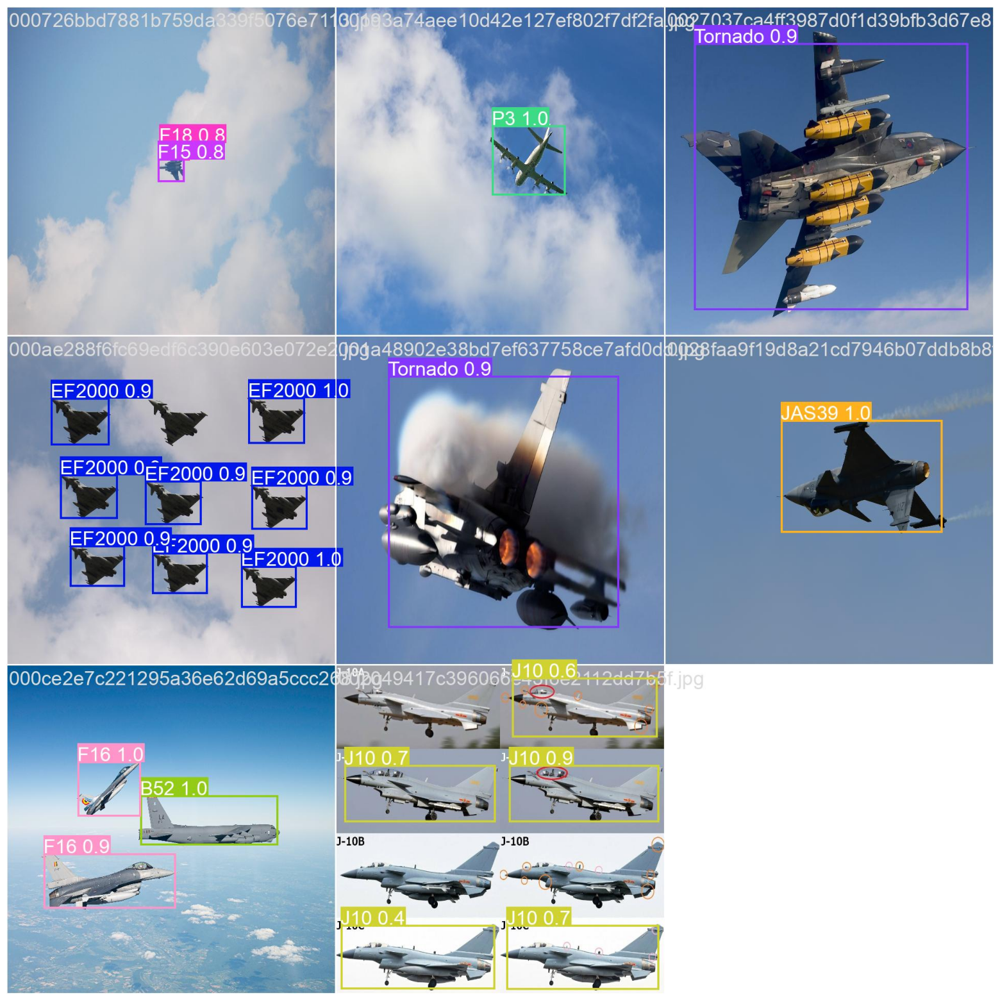

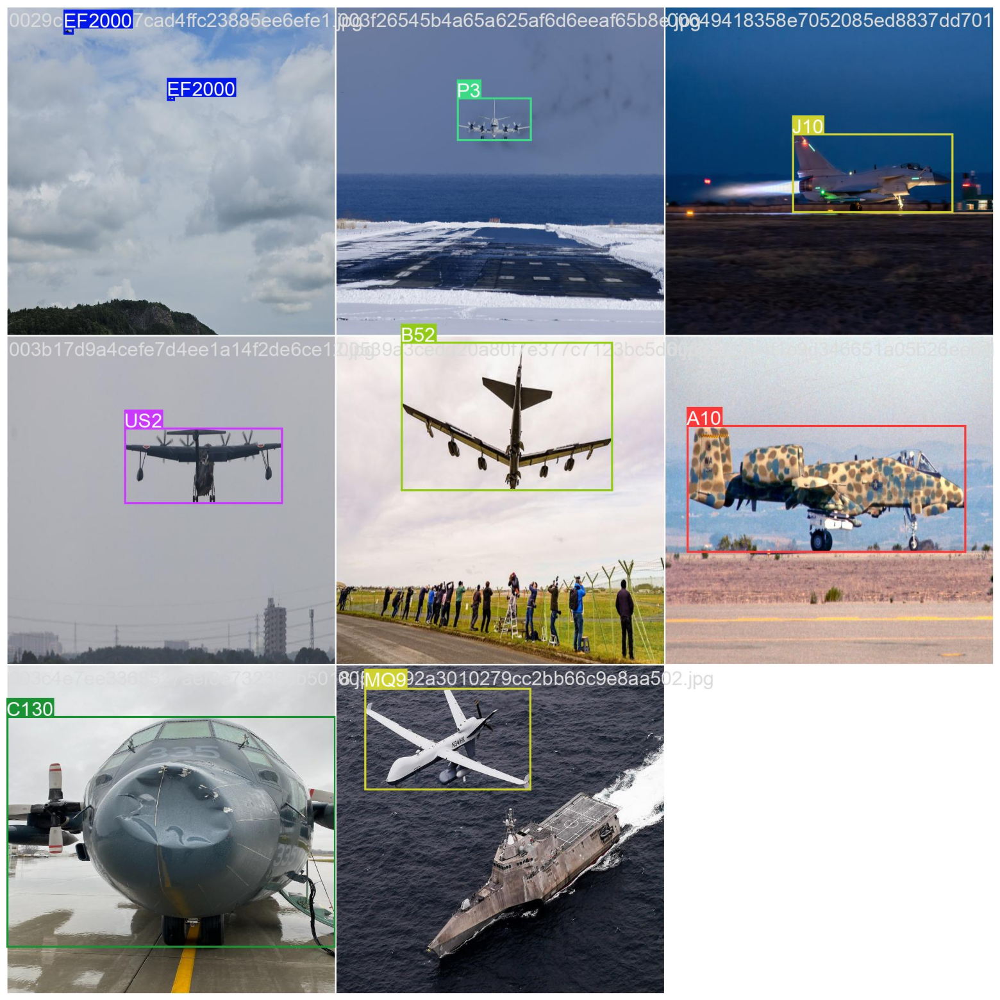

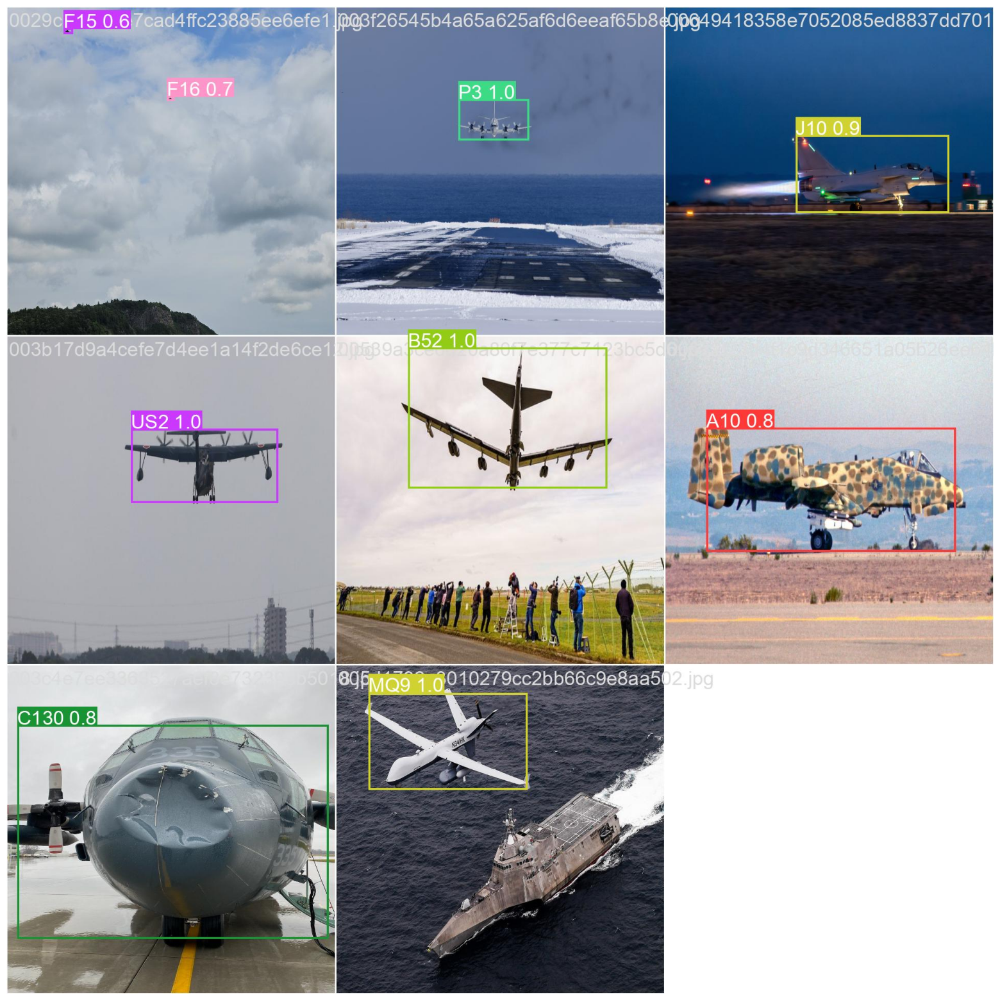

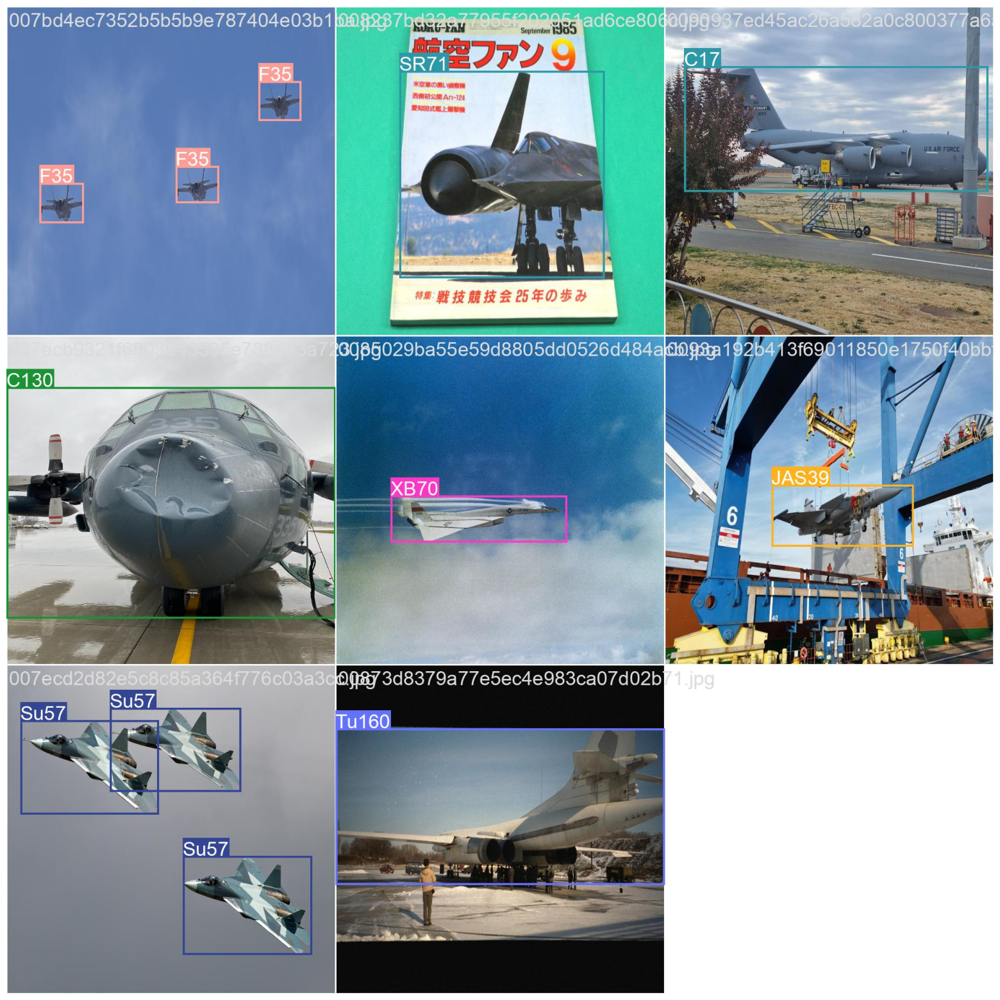

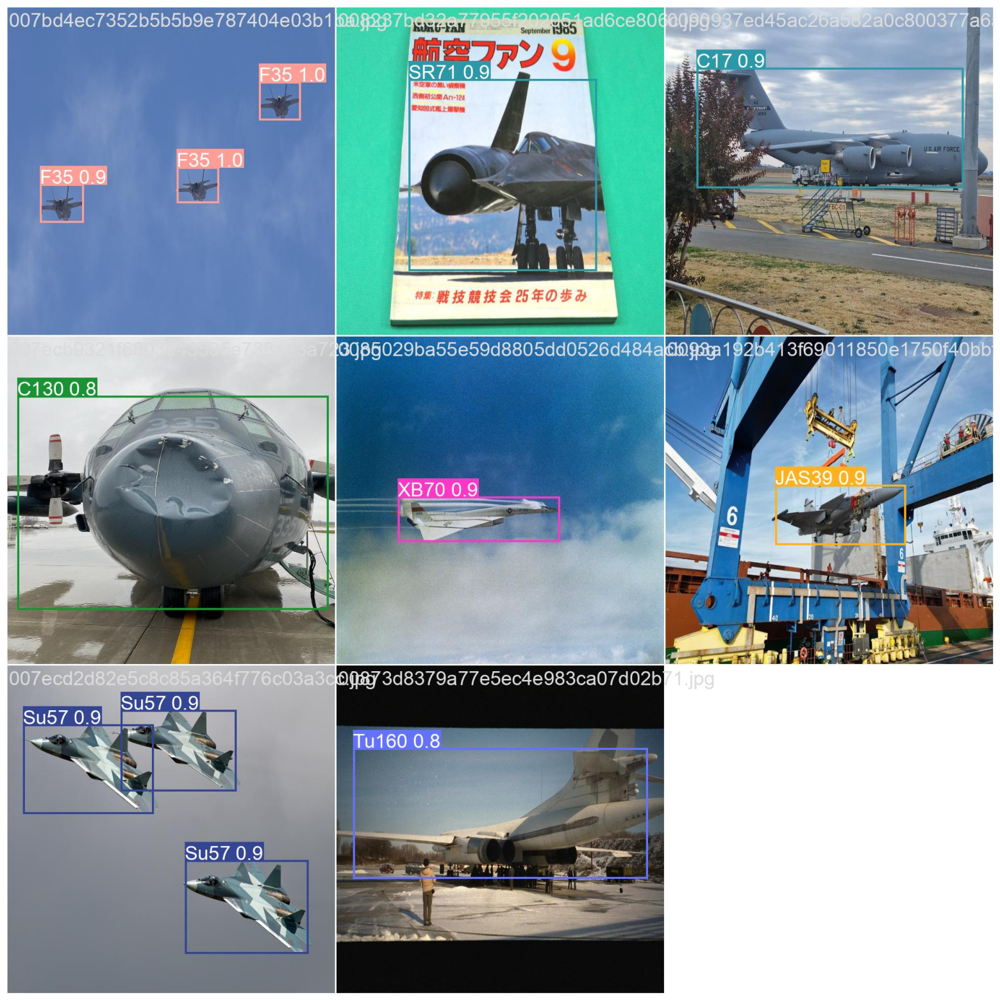

In [ ]:
# Loop through images in the specified directory
for path in sorted(glob.glob('/content/runs/detect/val3/*.jpg')):
    # Read the image
    image = cv2.imread(path)

    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Display the image
    plt.figure(figsize=(20, 20))
    plt.imshow(image_rgb)
    plt.axis('off')  # Turn off axis
    plt.show()